In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix,ConfusionMatrixDisplay
from sklearn import preprocessing,metrics
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
import pandas as pd
import matplotlib.pyplot as pl
from sklearn.ensemble import AdaBoostClassifier
import graphviz
from sklearn import tree

In [2]:
X=pd.read_csv('Cleaned_data.csv')
y=pd.read_csv('train_labels.csv')


In [3]:
X_train, X_test, y_train, y_test = train_test_split(X, y['damage_grade'], test_size = 0.3, random_state = 98)

### Logistic Regression

In [4]:
model=LogisticRegression(max_iter=5000)
model.fit(X_train,y_train)
train_acc = model.score(X_train, y_train)
print("The Accuracy for Training Set is {}".format(train_acc*100))
y_pred=model.predict(X_test)
test_acc = accuracy_score(y_test, y_pred)
print("The Accuracy for Test Set is {}".format(test_acc*100))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)

The Accuracy for Training Set is 57.606073895406205
The Accuracy for Test Set is 57.26327368542229
Classification report : 
               precision    recall  f1-score   support

           1       0.52      0.21      0.30      7483
           2       0.58      0.94      0.72     44326
           3       0.51      0.05      0.09     26372

    accuracy                           0.57     78181
   macro avg       0.54      0.40      0.37     78181
weighted avg       0.55      0.57      0.47     78181



### Knn Classifier

In [5]:
knn=KNeighborsClassifier(n_neighbors=3)
knn.fit(X_train,y_train)
y_pred=knn.predict(X_test)
score=knn.score(X_train,y_train)
print("The Accuracy for Training Set is {}".format(score*100))
print("The Accuracy for Testing Set is {}".format(metrics.accuracy_score(y_test,y_pred)*100))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)

The Accuracy for Training Set is 82.35500493366955
The Accuracy for Testing Set is 68.79292922832914
Classification report : 
               precision    recall  f1-score   support

           1       0.51      0.51      0.51      7483
           2       0.73      0.76      0.74     44326
           3       0.67      0.62      0.64     26372

    accuracy                           0.69     78181
   macro avg       0.64      0.63      0.63     78181
weighted avg       0.69      0.69      0.69     78181



### Regression Tree Classifier

In [6]:
clf = DecisionTreeClassifier(max_depth=15)
clf = clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)
print("Testing Accuracy:",metrics.accuracy_score(y_test, y_pred))
print("Error Rate is:",1-metrics.accuracy_score(y_test, y_pred))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)

Testing Accuracy: 0.6936851664726724
Error Rate is: 0.3063148335273276
Classification report : 
               precision    recall  f1-score   support

           1       0.56      0.45      0.50      7483
           2       0.71      0.79      0.75     44326
           3       0.69      0.59      0.64     26372

    accuracy                           0.69     78181
   macro avg       0.65      0.61      0.63     78181
weighted avg       0.69      0.69      0.69     78181



In [10]:
dot_data = tree.export_graphviz(clf, class_names=['1', '2','3'], out_file=None)
graph = graphviz.Source(dot_data)
graph

### Adaboost Ensembling Technique

In [11]:
a=dict()
aclf = AdaBoostClassifier(n_estimators=50,base_estimator=clf)
aclf = aclf.fit(X_train,y_train)
y_pred = aclf.predict(X_test)
a[50]=metrics.accuracy_score(y_test, y_pred)*100
print('Running with estimators:'+ str(50)+" getting an accuracy of: "+str(a[50]))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)

Running with estimators:50 getting an accuracy of: 65.90092221895345
Classification report : 
               precision    recall  f1-score   support

           1       0.58      0.43      0.50      7483
           2       0.69      0.75      0.72     44326
           3       0.62      0.57      0.59     26372

    accuracy                           0.66     78181
   macro avg       0.63      0.58      0.60     78181
weighted avg       0.65      0.66      0.65     78181



###### with learning rate as default and 50 estimators accuracy is 65.9

###### with learning rate 0.02 and 700 estimators accuracy is 66.8  with learning rate 0.002 and 1000 estimators accuracy is 70.3 with learning rate 0.002 and 2000 estimators accuracy is 70


In [12]:
aclf = AdaBoostClassifier(n_estimators=1000,base_estimator=clf,learning_rate=0.002)
aclf = aclf.fit(X_train,y_train)
y_pred = aclf.predict(X_test)
print("Testing Accuracy:",metrics.accuracy_score(y_test, y_pred))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)

Testing Accuracy: 0.7025747943873831
Classification report : 
               precision    recall  f1-score   support

           1       0.62      0.41      0.50      7483
           2       0.71      0.83      0.76     44326
           3       0.71      0.57      0.63     26372

    accuracy                           0.70     78181
   macro avg       0.68      0.61      0.63     78181
weighted avg       0.70      0.70      0.69     78181



### XGBoost ensembling Technique with evaluation metric as mlogloss

In [13]:
import xgboost as xgb
clf = xgb.XGBClassifier(
    n_estimators=2000,
    objective='multi:softmax',
    num_class=3,
    max_depth=12, 
    learning_rate=0.02, 
    subsample=0.8,
    colsample_bytree=0.4, 
    missing=-1, 
    eval_metric='mlogloss',
    nthread=40,
    tree_method='hist'
    )
clf = clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)
print("Testing Accuracy:",metrics.accuracy_score(y_test, y_pred))
print("Error Rate is:",1-metrics.accuracy_score(y_test, y_pred))
matrix = classification_report(y_test,y_pred,labels=[1,2,3])
print('Classification report : \n',matrix)

C:\Users\anant\anaconda3\envs\tf_gpu\lib\site-packages\xgboost\sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


Testing Accuracy: 0.7391309909057188
Error Rate is: 0.26086900909428123
Classification report : 
               precision    recall  f1-score   support

           1       0.67      0.51      0.58      7483
           2       0.74      0.84      0.79     44326
           3       0.75      0.63      0.69     26372

    accuracy                           0.74     78181
   macro avg       0.72      0.66      0.68     78181
weighted avg       0.74      0.74      0.73     78181



### Naive Bayes classiffier

Accuracy: 0.4786
Error rate: 0.5214


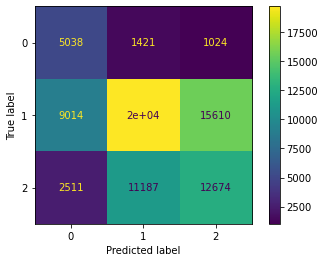

In [14]:
clf_gb = GaussianNB(priors = [0.5, 0.4,0.1])
# training
clf_gb.fit(X_train, y_train)

# testing
predict = clf_gb.predict(X_test)
accuracy_dt = accuracy_score(y_test,predict)
print('Accuracy: {:.4}\nError rate: {:.4f}'.format(accuracy_dt, 1-accuracy_dt))

cm = confusion_matrix(y_test,predict)
ConfusionMatrixDisplay(cm).plot()

#### Class priors = [0.5, 0.4,0.1] acc= 0.478    [0.3, 0.4,0.3] acc = 0.426   [0.6, 0.3,0.1] acc= 0.445 [0.4, 0.4,0.2] acc= 0.4346

In [15]:
matrix = classification_report(y_test,predict,labels=[1,2,3])
print('Classification report : \n',matrix)

Classification report : 
               precision    recall  f1-score   support

           1       0.30      0.67      0.42      7483
           2       0.61      0.44      0.51     44326
           3       0.43      0.48      0.46     26372

    accuracy                           0.48     78181
   macro avg       0.45      0.53      0.46     78181
weighted avg       0.52      0.48      0.49     78181

